In [1]:
import plotly.graph_objects as go
import numpy as np
from guang.interesting import Lorenz
from guang.Utils.plotly import Scatter3d

guang.__version__=: 0.0.7.9.9


In [2]:
t = np.linspace(0, 10, 900)

Traces=[]
k = 3
for i in range(k):
    Traces.append(Lorenz.Trace(t = t, xyz=[10*np.random.rand(),10*np.random.rand(),10*np.random.rand()+10]))

In [3]:
trace = Traces[0]
x,y,z = trace[:,0], trace[:,1], trace[:,2]

def getRange(x, dx=1.5):
    return np.min(x) - dx, np.max(x) + dx

xm, xM = getRange(x)
ym, yM = getRange(y)
zm, zM = getRange(z)

In [4]:
class ExtremeValue:
    """Find Extreme Value
    Example:
    ```
    Value = ExtremeValue()
    for x, y in zip(X, Y):
        x_min, y_min = Value.get_min(x=x, y=y)
        x_max, y_max = Value.get_max(x=x, y=y)
    ```
    """
    def __init__(self):
        self.x_min = {}
        self.x_max = {}
        
        
    def get_min(self, **x):
        res = []
        for key in x:
            self.x_min.setdefault(key, np.inf)
            if x[key] < self.x_min[key]:
                self.x_min[key] = x[key]
            res.append(self.x_min[key])
        if len(res) > 1:
            return res
        else:
            return res[0]
    
    def get_max(self, **x):
        res = []
        for key in x:
            self.x_max.setdefault(key, -np.inf)
            if x[key] > self.x_max[key]:
                self.x_max[key] = x[key]
            res.append(self.x_max[key])
        if len(res) > 1:
            return res
        else:
            return res[0]
         

In [5]:
Value = ExtremeValue()
for trace in Traces:
    x,y,z = trace[:,0], trace[:,1], trace[:,2]
    xm, xM = getRange(x)
    ym, yM = getRange(y)
    zm, zM = getRange(z)
    xm, ym, zm = Value.get_min(x=xm, y=ym, z=zm)
    xM, yM, zM = Value.get_max(x=xM, y=yM, z=zM)
    
xM, yM, zM, xm, ym, zm

(20.19388893355419, 26.97973506455327, 47.61588980736656, -18.987804723150724,
 -24.736368982822555, 2.1646156026916556)

In [6]:
all_steps = 100
N = len(x)
step = N//all_steps
i_start, i_end = 0, 0

frames = []

for i in range(all_steps):
    i_start += step
    i_end += step
    data = []
    
    for trace in Traces:
        x,y,z = trace[:,0], trace[:,1], trace[:,2]

        
        data_x = x[:i_end]
        data_y = y[:i_end]
        data_z = z[:i_end]
        data.append(go.Scatter3d(x = data_x, y=data_y, z=data_z,
#                                                    mode="markers",
                                                    mode = "lines+markers",
                                                    line=dict(
                                                    color=None,
                                                    width=1.5
                                                          ),
                                                   marker=dict(
                                                   size = 1.5, 
                                                   color = z,
                                                   colorscale='Viridis')) )
        
    frames.append(go.Frame(data = data, 
                           traces =[i for i in range(len(data))] ####THIS IS THE LINE THAT MUST BE INSERTED
                          )
                 )

In [7]:
initial_data = [go.Scatter3d(x=[xm], y=[ym], z=[zm]), 
               go.Scatter3d(x=[xM], y=[yM], z=[zM]), 
               go.Scatter3d(x=[xm], y=[yM], z=[zm]), ]



layout = go.Layout(width=780, height=780,
         
        scene={
        'xaxis': {'range': [xm, xM], "nticks":10, 'autorange':False,"zeroline":False},#, 'rangemode': 'tozero', 'tickmode': "linear", 'tick0': -5, 'dtick': 1},
        'yaxis': {'range': [ym, yM], "nticks":10, 'autorange':False,"zeroline":False},#, 'rangemode': 'tozero', 'tickmode': "linear", 'tick0': -5, 'dtick': 1},
        'zaxis': {'range': [zm, zM], "nticks":10, 'autorange':False,"zeroline":False},#, 'rangemode': 'tozero', 'tickmode': "linear", 'tick0': -5, 'dtick': 1},
        'aspectmode': 'cube',
        },
         title="Moving Frenet Frame Along a Planar Curve",
         hovermode="closest",
         updatemenus=[dict(type="buttons",
                           buttons=[dict(label="Play",
                                     method="animate",
                                     args=[None, dict(frame=dict(duration=10, redraw=True),
                                    transition=dict(duration=0),
                                    fromcurrent=True,
                                    mode='immediate'
                                                     )])])])

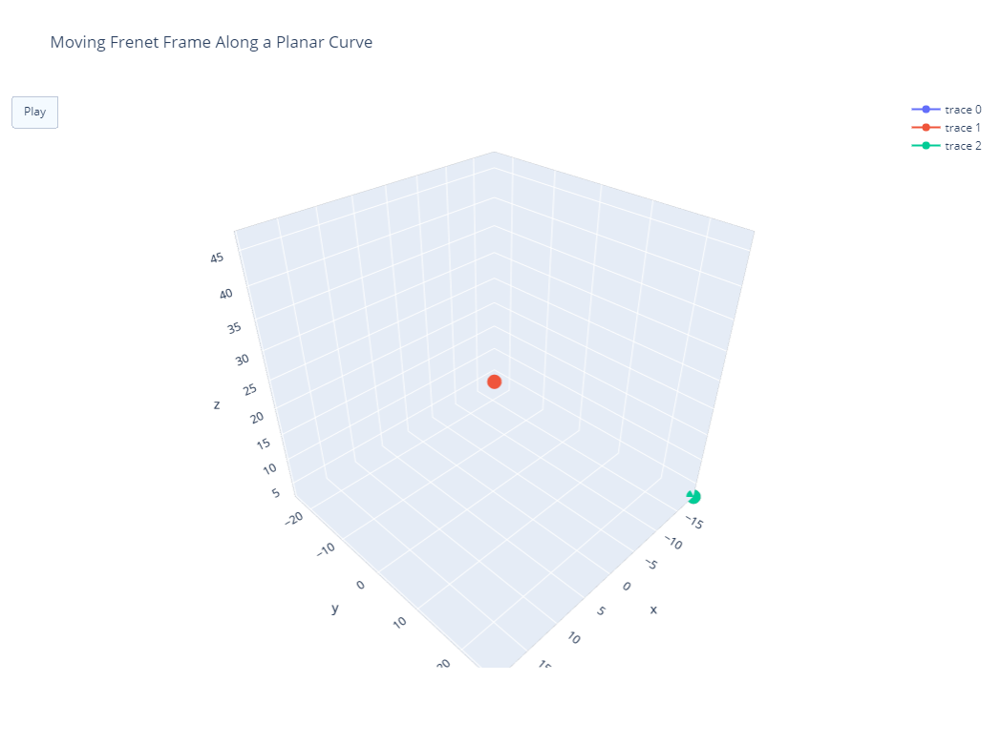

In [8]:
fig = go.Figure(
    
    data=initial_data,
    
    layout=layout,
    
    frames= frames
)

fig.show()

In [146]:
# N = 1000
# x = np.linspace(0, 2*np.pi, N)
# y = np.cos(x)
t = np.linspace(0, 10, 900)
Traces=[]
k = 3
for i in range(k):
    Traces.append(Lorenz.Trace(t = t, xyz=[10*np.random.rand(),10*np.random.rand(),10*np.random.rand()+10]))
trace = Traces[0]
x,y,z = trace[:,0], trace[:,1], trace[:,2]

In [166]:
all_steps = 200

step = N//all_steps
i_start, i_end = 0, 0
period = 300
frames = []
for i in range(all_steps):
    i_end += step
    i_start = i_end-period if i_end >period else 0
    data_x = x[i_start:i_end]
    data_y = y[i_start:i_end]
    frames.append(go.Frame(data=[go.Scatter(
                        x=data_x,
                        y=data_y,
                        mode="lines",
                        line=dict(color=None, width=2)) ])
                 )

In [173]:
a=[1,2,3,4,5]


[]

In [169]:

initial_data = [
          go.Scatter(),
          ]


layout = go.Layout(width=780, height=780,
         xaxis=dict(range=[xm, xM], autorange=False, zeroline=False),
         yaxis=dict(range=[ym, yM], autorange=False, zeroline=False),
         title="Lorenz X-Y 2D Curve",
         hovermode="closest",
         updatemenus=[dict(type="buttons",
                           buttons=[dict(label="Play",
                                     method="animate",
                                     args=[None, dict(frame=dict(duration=30, redraw=False),
                                    transition=dict(duration=0),fromcurrent=True,mode='immediate')])])])

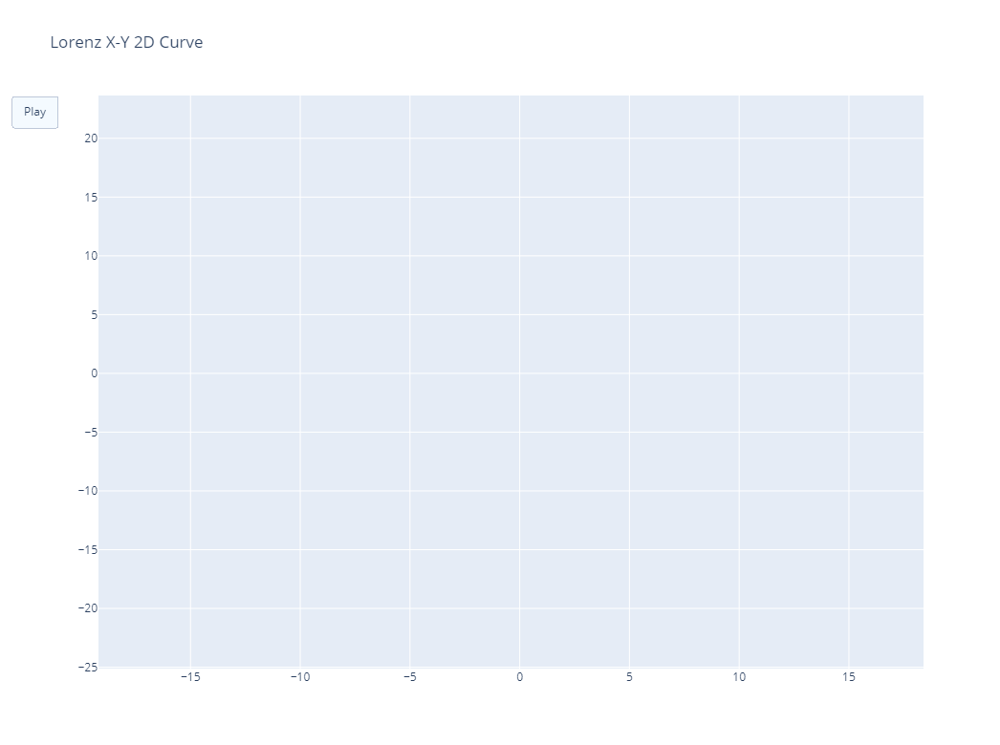

In [170]:
fig = go.Figure(
    
    data=initial_data,
    
    layout=layout,
    
    frames= frames
)

fig.show()

In [28]:
import plotly.graph_objects as go
import numpy as np
from guang.Utils.mathFunc import sawtooth

guang.__version__=: 0.0.7.9.8


In [72]:
COUNTS = 1000
t = np.linspace(0, 6*np.pi, COUNTS)
N = 60
# step 1 :创建图窗fig，添加所有图到fig中, visible置于False
# Create figure
fig = go.Figure()
for step in range(N):
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="#00CED1", width=1.5), # --------------- 1
            name="ord = " + str(step), # --------------- 2
            x = t, # --------------- 3
            y = sawtooth(step, t) # --------------- 4
        )
    )

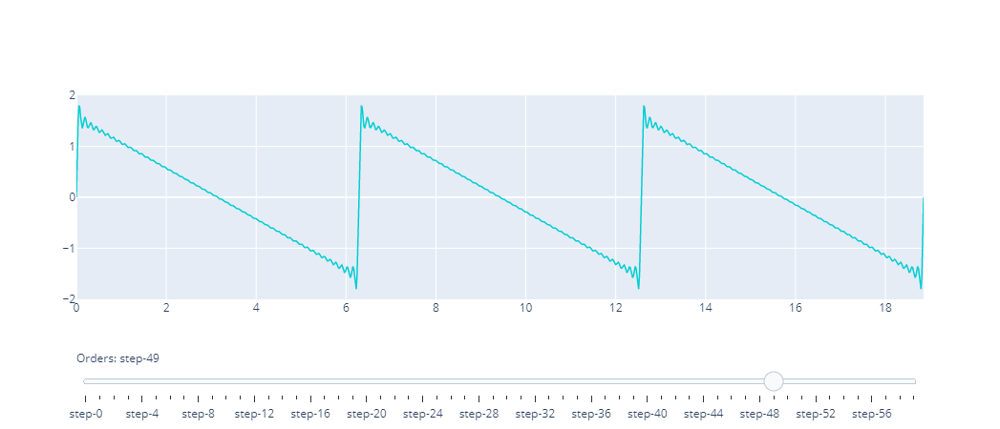

In [73]:
# step 2： 初始化图像
# Make 10th trace visible
initial_step = 1 # --------------- 5
fig.data[initial_step].visible = True

# step 3: 设置steps （对于sliders而言，这一步都是一样的, 就是每一次使一张图像的visible=True,其余都是False）
# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="restyle",
        args=["visible", [False] * len(fig.data)],
    )
    step["args"][1][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)
    
sliders = [dict(
    active=initial_step,
    currentvalue={"prefix": "Orders: "},# --------------- 6
    pad={"t": 50}, # --------------- (7)
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

In [74]:
fig.write_html("pictures/sawtooth.html")

In [2]:
import plotly.express as px
df = px.data.gapminder()

In [3]:
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4


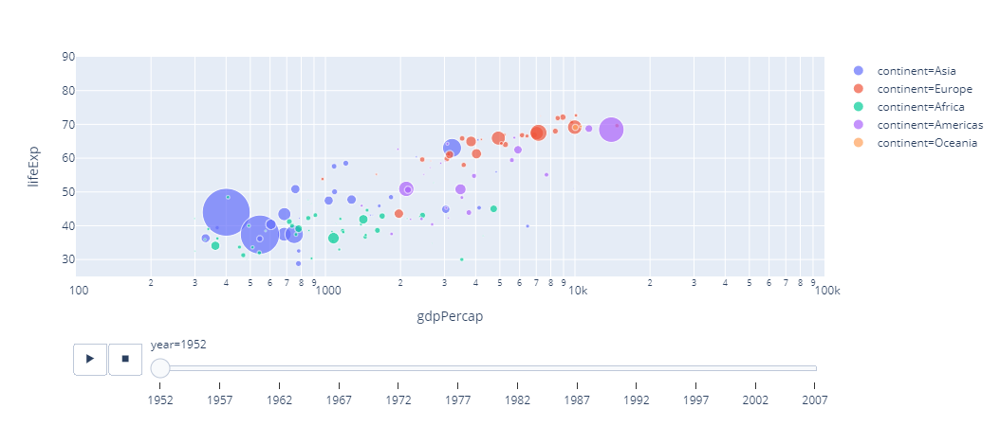

In [4]:
# 这里的动画效果看起来很不错，操作也很简单
# 但是，这里的x和y 一次只能对应一个数字，而不能是一个数组
# 所以比较适合表格数据的可视化
# 并不适合数学物理中的线面等图像
px.scatter(df, 
           x="gdpPercap", 
           y="lifeExp", 
           animation_frame="year", 
           animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

In [11]:
x[None,:]

array([[0.        , 0.00628947, 0.01257895, 0.01886842, 0.0251579 ,
        0.03144737, 0.03773685, 0.04402632, 0.0503158 , 0.05660527,
        0.06289475, 0.06918422, 0.0754737 , 0.08176317, 0.08805265,
        0.09434212, 0.1006316 , 0.10692107, 0.11321055, 0.11950002,
        0.1257895 , 0.13207897, 0.13836845, 0.14465792, 0.15094739,
        0.15723687, 0.16352634, 0.16981582, 0.17610529, 0.18239477,
        0.18868424, 0.19497372, 0.20126319, 0.20755267, 0.21384214,
        0.22013162, 0.22642109, 0.23271057, 0.23900004, 0.24528952,
        0.25157899, 0.25786847, 0.26415794, 0.27044742, 0.27673689,
        0.28302637, 0.28931584, 0.29560531, 0.30189479, 0.30818426,
        0.31447374, 0.32076321, 0.32705269, 0.33334216, 0.33963164,
        0.34592111, 0.35221059, 0.35850006, 0.36478954, 0.37107901,
        0.37736849, 0.38365796, 0.38994744, 0.39623691, 0.40252639,
        0.40881586, 0.41510534, 0.42139481, 0.42768429, 0.43397376,
        0.44026323, 0.44655271, 0.45284218, 0.45